# Python ile Varlık Tahsisi

Varlık tahsisi, herhangi bir yatırımcının karşı karşıya kalması gereken en önemli karardır ve her bir yatırımcı için çalışabilecek tek bir boyuta sahip çözüm yoktur. Varlık tahsisi ile, yatırımcının toplam yatırım tutarını belirli varlıklara (stoklar, opsiyonlar, tahviller veya diğer finansal araçlar). Tahsisi dikkate alırken, yatırımcı riski ve potansiyel ödülü dengelemek ister. Aynı zamanda tahsis, bireysel hedefler (beklenen getiri), risk toleransı (yatırımcının kabul etmek istediği riskin miktarı) veya yatırım ufku (kısa veya uzun vadeli yatırım) gibi faktörlere bağlıdır.

Varlık tahsisinde anahtar çerçeve **modern portföy teorisidir**(**MPT**, **ortalama varyans analizi** olarak da bilinir). Nobel alıcısı Harry Markowitz tarafından tanıtıldı ve riske karşı yatırımcıların belirli bir risk seviyesi için beklenen getirilerini (karlarını) en üst düzeye çıkarmak için portföyleri nasıl inşa edebileceklerini açıklıyor. MPT'nin ana görüşü, yatırımcıların bir varlığın performansını tek başına değerlendirmemesi (beklenen getiri veya oynaklık gibi metriklerle) değil, bunun yerine varlık portföylerinin performansını nasıl etkileyeceğini araştırmasıdır.

MPT, çeşitlendirme kavramı ile yakından ilişkilidir; bu, farklı varlık türlerine sahip olmanın riski azalttığı anlamına gelir - belirli bir güvenliğin kaybı veya kazancı portföyün performansı üzerinde daha az etkiye sahiptir. Dikkat edilmesi gereken bir diğer önemli kavram, portföy getirisinin münferit varlık getirilerinin ağırlıklı ortalaması olmasına rağmen, bu riskin (oynaklık) doğru olmadığıdır. Ayrıca, varlıklar arasındaki korelasyonlara da bağlıdır. İlginç olan, optimize edilmiş varlık tahsisi sayesinde, portföydeki varlıkların en düşük bireysel oynaklığından daha düşük volatiliteye sahip bir portföye sahip olmanın mümkün olmasıdır. Prensip olarak, elimizdeki varlıklar arasındaki korelasyon ne kadar düşükse, çeşitlendirme için o kadar iyidir. Mükemmel bir negatif korelasyon ile tüm riski çeşitlendirebiliriz.

Modern portföy teorisinin ana varsayımları:
* Yatırımcılar rasyoneldir ve mümkün olduğunca risklerden kaçınırken getirilerini en üst düzeye çıkarmayı amaçlar.
* Yatırımcılar, beklenen getirilerini en üst düzeye çıkarma hedefini paylaşırlar.
* Tüm yatırımcılar potansiyel yatırımlar hakkında aynı seviyede bilgiye sahiptir.
* Komisyonlar, vergiler ve işlem maliyetleri dikkate alınmaz.
* Yatırımcılar risksiz bir oranda (sınırsız) borç alabilir ve borç verebilir.

Bu bölümde, en temel varlık tahsisi stratejisiyle başlıyoruz ve temelinde portföylerin (bireysel varlıklar için de geçerlidir) performansının nasıl değerlendirileceğini öğreniyoruz. Daha sonra, Verimli Sınır'ı elde etmek için üç farklı yaklaşım gösterirken, MPT'nin bazı varsayımlarını da rahatlatıyoruz. Optimizasyon problemlerine nasıl yaklaşılacağını öğrenmenin temel faydalarından biri, örneğin farklı bir objektif işlevi optimize etmek üzere kolayca yeniden düzenlenebilmeleridir. Bu, çerçevenin büyük bir kısmı aynı kalırken kodda sadece küçük değişiklikler yapılmasını gerektirir.

# 1.Basit bir *1/n* portföyünün performansının değerlendirilmesi

En temel varlık tahsisi stratejisini incelemekle başlıyoruz: **1 / n portföy**. Fikir, dikkate alınan tüm varlıklara eşit ağırlıklar atamak ve böylece portföyü çeşitlendirmektir. Bu kadar basit, DeMiguel, Garlappi ve Uppal (2007), daha gelişmiş varlık tahsisi stratejileri kullanarak 1 / n portföyünün performansını yenmenin zor olabileceğini gösteriyor.

Tarifin amacı, 1 / n portföyün nasıl oluşturulacağını, getirilerinin nasıl hesaplanacağını ve sonra tüm ilgili portföy değerlendirme metriklerini bir reklam sayfası şeklinde hızlı bir şekilde elde etmek için `pyfolio` adlı bir Python kütüphanesini nasıl kullanacağını göstermektir. Tarihsel olarak, bir reklam sayfası kamu şirketleri hakkında önemli bilgileri özetleyen kısa, genellikle bir sayfalık bir belgedir.

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import warnings
import seaborn as sns

plt.style.use('seaborn')
sns.set_palette('cubehelix')
# plt.style.use('seaborn-colorblind') #alternative
plt.rcParams['figure.figsize'] = [8, 4.5]
plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)

Kütüphanelerin çağırılması:

In [4]:
import yfinance as yf
import numpy as np
import pandas as pd
import pyfolio as pf

Parametrelerin oluşturulması:

In [5]:
RISKY_ASSETS = ['AAPL', 'IBM', 'MSFT', 'TWTR']
START_DATE = '2017-01-01'
END_DATE = '2018-12-31'

n_assets = len(RISKY_ASSETS)

Yahoo finanstan stokların indirilmesi:

[*********************100%***********************]  4 of 4 completed
Downloaded 501 rows of data.


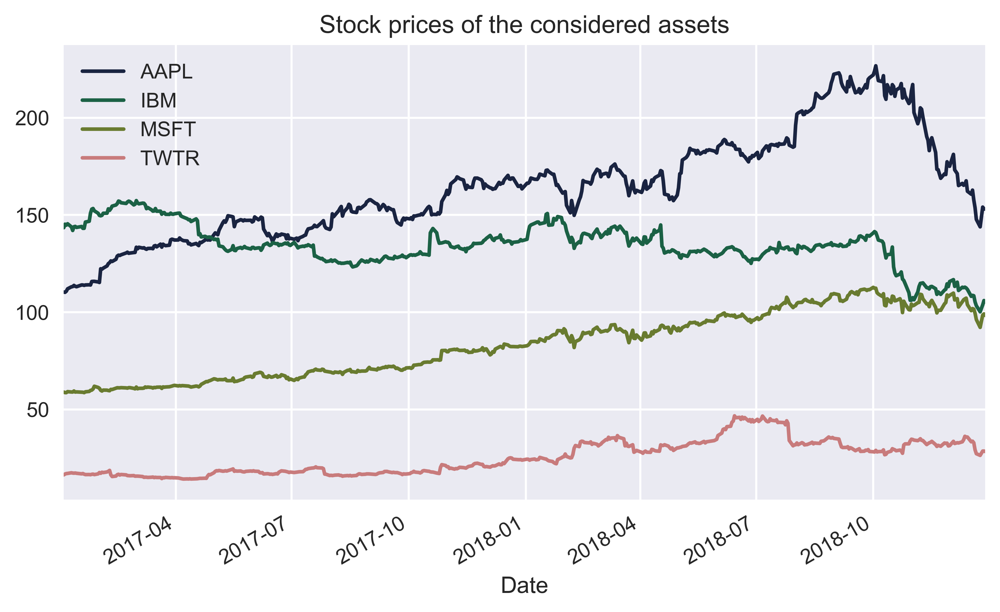

In [6]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')
prices_df['Adj Close'].plot(title='Stock prices of the considered assets')

Bireysel varlık getirilerinin hesaplanması:

In [7]:
returns = prices_df['Adj Close'].pct_change().dropna()

Ağırlıkların tanımlanması:

In [8]:
portfolio_weights = n_assets * [1 / n_assets]

Portföy getirilerinin hesaplanması:

In [9]:
portfolio_returns = pd.Series(np.dot(portfolio_weights, returns.T), 
                              index=returns.index)

Reklam sayfasının hazırlanması:

In [10]:
pf.create_simple_tear_sheet(portfolio_returns)

Start date,2017-01-04
End date,2018-12-28
Total months,23
,Backtest
Annual return,17.7%
Cumulative returns,38.1%
Annual volatility,21.8%
Sharpe ratio,0.86
Calmar ratio,0.70
Stability,0.87
Max drawdown,-25.3%


Buradaki metrikler:

* **Sharpe oranı**: En popüler performans değerlendirme metriklerinden biri, standart sapma birimi başına fazla getiriyi (risksiz oranın üzerinde) ölçer. Risksiz oran sağlanmadığında, varsayılan varsayım % 0'a eşit olduğudur. Sharpe oranı ne kadar yüksek olursa, portföyün riske göre ayarlanmış performansı o kadar iyi olur.
* **Maksimum düşüş(max drawdown)**: Bir portföyün aşağı yönlü riskinin bir metriği olarak, yatırım sırasında en büyük zirveden vadiye kaybını (yüzde olarak ifade edilir) ölçer. Maksimum düşüş ne kadar düşükse, o kadar iyidir.
* **Calmar oranı**: Oran, yıllık ortalama bileşik getiri oranının aynı zaman dilimi için maksimum çekime bölünmesiyle tanımlanır. Oran ne kadar yüksek olursa o kadar iyidir.
* **Kararlılık(Stability)**: Kümülatif kütük dönüşlerine doğrusal uyumun R karesi olarak ölçülür. Pratikte, bu, kümülatif günlük dönüşlerinde bir dizi tamsayı (zaman endeksi olarak hizmet eder) regress anlamına gelir.
* **Omega oranı**: Kazançların belirlenen dönüş hedefi eşiği için kayıplar üzerindeki olasılık ağırlıklı oranı (varsayılan 0'a ayarlıdır). Sharpe oranına göre ana avantajı, Omega oranının (inşaat yoluyla) getiri dağılımının tüm anlarını dikkate alması, birincisi ise sadece ilk ikisini (ortalama ve varyans) dikkate almasıdır.
* **Sortino oranı**: Paydadaki standart sapmanın, aşağı sapma ile değiştirildiği Sharpe oranının değiştirilmiş bir versiyonu.
* **Çarpıklık**: Çarpıklık asimetri derecesini, yani verilen dağılımın (burada portföy getirilerinin) Normal dağılımdan daha fazla çarpıklığını ölçer. Negatif çarpıklık (sol çarpık dağılımlar), büyük negatif getirilerin büyük pozitif olanlardan daha sık meydana geldiği anlamına gelir.
* **Basıklık**: Her iki kuyruktaki aşırı değerleri ölçer. Büyük basıklıklı dağılımlar Gauss dağılımının kuyruklarını aşan kuyruk verileri sergiler, bu da büyük ve küçük geri dönüşlerin daha sık meydana geldiği anlamına gelir.
* **Kuyruk oranı**: Günlük getirilerin 95. ve 5. persentilleri arasındaki oran (mutlak). ~ 0.8'lik bir kuyruk oranı, kayıpların kardan ~ 1.25 kat daha kötü olduğu anlamına gelir.
* **Günlük risk altındaki değer**: μ - 2σ olarak hesaplanır; burada μ, dönem boyunca ortalama portföy getirisi ve σ karşılık gelen standart sapmadır.

Aşağı yönlü sapma standart sapmaya benzer; ancak, yalnızca negatif getirileri dikkate alır - serideki tüm olumlu değişiklikleri atar. Aynı zamanda (yatırımcıya bağlı olarak) farklı asgari kabul edilebilir getiri seviyeleri tanımlamamıza izin verir ve aşağı yönlü sapmayı hesaplamak için bu eşiğin altındaki getiri kullanılır.

Grafikler:

* **Birikimli getiri grafiği**: Portföyün zaman içindeki değerinin gelişimini sunar.
* **Hareketli Sharpe oranı**: Zaman içinde bir sayıyı bildirmek yerine Sharpe oranının ne kadar kararlı olduğunu görmek de ilginçtir. Bu nedenle, aşağıdaki grafik 6 metrelik veri kullanarak yuvarlanarak hesaplanmış bu metriği sunmaktadır.
* **Sualtı grafiği (sualtı eşitlik eğrisi olarak da bilinir)**: Bu grafik, yatırımları zararlara odaklandığından kötümser bir bakış açısıyla sunar. Değer, yeni bir zirveye yükselene kadar tüm düşüş dönemlerini ve ne kadar sürdüğünü çiziyor. Bundan yararlanabileceğimiz içgörülerden biri, kayıp sürelerinin ne kadar sürdüğüdür:

Önceden, zaten birçok yararlı metrik içerdiği için `pf.create_simple_tear_sheet` yöntemini kullanıyorduk. Daha fazla ayrıntı elde etmek için `pf.create_returns_tear_sheet` yöntemini kullanabiliriz.

In [11]:
pf.create_returns_tear_sheet(portfolio_returns)

Start date,2017-01-04
End date,2018-12-28
Total months,23
,Backtest
Annual return,17.7%
Cumulative returns,38.1%
Annual volatility,21.8%
Sharpe ratio,0.86
Calmar ratio,0.70
Stability,0.87
Max drawdown,-25.3%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,25.32,2018-07-25,2018-12-24,NaT,NaN
1,10.93,2018-03-12,2018-04-02,2018-06-01,60
2,6.93,2017-07-20,2017-07-31,2017-10-12,61
3,6.71,2018-02-01,2018-02-05,2018-02-12,8
4,5.48,2017-02-08,2017-04-19,2017-05-01,59


İlginç yeni özelliklerden bazıları:

* En büyük beş düşüş dönemine sahip bir tablo: düşüşün ne kadar kötü olduğu, tepe / vadi tarihleri, iyileşme tarihi ve süresi. Bu tablo sualtı planının analizini tamamlar.
* İlk beş düşüş periyodu ayrı bir grafik üzerinde görselleştirilir.
* Portföy getirilerinin dağılımını açıklayan grafikler: getirilerin belirli aylar / yıllar boyunca ne olduğu, aylık getirilerin nasıl dağıtıldığı ve getirilerin miktarları farklı frekanslar kullanılarak özetlenmiştir. 

pyfolio, Quantopian ekibi tarafından geliştirildi ve bağımsız bir kütüphane olarak gerçekten iyi çalışıyor. Bununla birlikte, Quantopian tarafından geliştirilen geri test ve canlı ticaret çerçevesi olan zipline ile de birleştirilebilir. Backtrader'a benzer şekilde, ticaret stratejilerinin geriye doğru test edilmesini kolaylaştıran bir çerçevedir. Pyfolio fonksiyon çağrılarına ekstra bilgi (zipline'dan elde edilen işlem / pozisyon detayları gibi) eklediğimizde, özet sayfasında daha fazla bilgi alırız.

Pyfolio özet sayfalarında sunulan performans / risk metriklerinin çoğu aslında Quantopian tarafından da geliştirilen empyrical adlı bir kütüphane kullanılarak hesaplanır. Doğrudan Omega oranı gibi belirli bir metrik hesaplamak istiyorsak doğrudan kullanabiliriz.

# 2.Monte Carlo simulasyonlarıyla etkin sınırın bulunması

Modern Portföy Teorisine göre, Efficient Frontier risk-getiri spektrumunda bir dizi optimum portföydür. Bu, sınırdaki portföylerin olduğu anlamına gelir:

* Belirli bir risk seviyesi için beklenen en yüksek getiriyi sunun
* Belirli bir beklenen getiri seviyesi için en düşük risk seviyesini sunun

Etkin Sınır eğrisi altında bulunan tüm portföyler en uygun değer olarak değerlendirilmez, bu nedenle sınırdaki olanları seçmek her zaman daha iyidir.

Burada, Monte Carlo simülasyonlarını kullanarak Etkin Sınırın nasıl bulunacağını gösteriyoruz. Rastgele atanan ağırlıkları kullanarak binlerce portföy oluşturuyoruz ve sonuçları görselleştiriyoruz. Bunu yapmak için, 2018'den dört ABD teknoloji şirketinin getirilerini kullanıyoruz.

Kütüphanelerin çağırılması:

In [12]:
import yfinance as yf
import numpy as np
import pandas as pd

Parametrelerin tanımlanması:

In [13]:
N_PORTFOLIOS = 10 ** 5
N_DAYS = 252
RISKY_ASSETS = ['FB', 'TSLA', 'TWTR', 'MSFT']
RISKY_ASSETS.sort()
START_DATE = '2018-01-01'
END_DATE = '2018-12-31'

n_assets = len(RISKY_ASSETS)

Yahoo finanstan verilerin çekilmesi:

In [14]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')

[*********************100%***********************]  4 of 4 completed
Downloaded 250 rows of data.


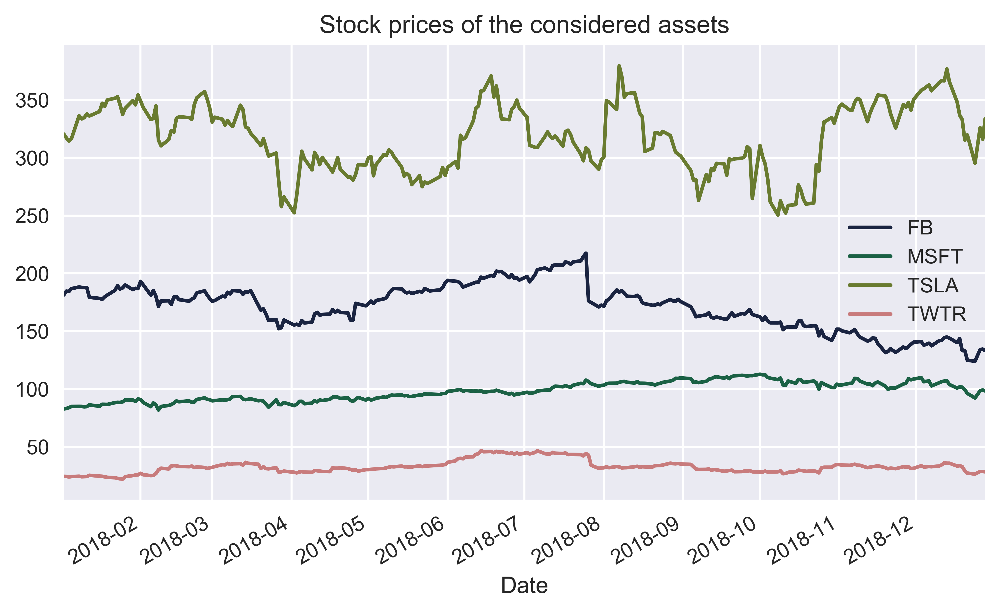

In [15]:
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

Yıllık ortalama getirilerin ve karşılık gelen standart sapmanın hesaplanması:

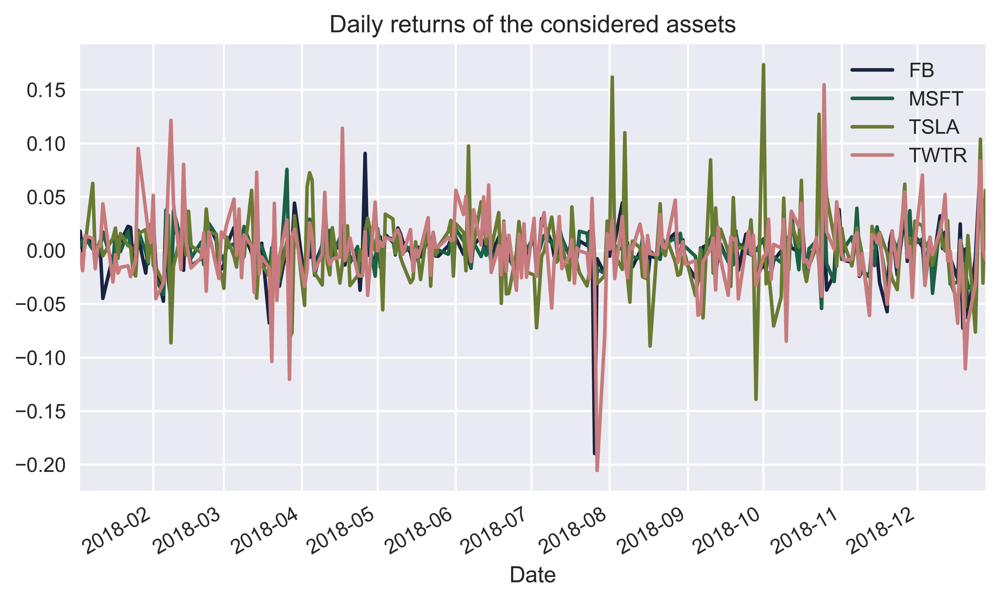

In [16]:
returns_df = prices_df['Adj Close'].pct_change().dropna()

avg_returns = returns_df.mean() * N_DAYS
cov_mat = returns_df.cov() * N_DAYS

returns_df.plot(title='Daily returns of the considered assets');

Rastgele portföy ağırlıklarının simulasyonu:

In [17]:
np.random.seed(42)
weights = np.random.random(size=(N_PORTFOLIOS, n_assets))
weights /=  np.sum(weights, axis=1)[:, np.newaxis]

Portföy metriklerinin hesaplanması:

In [18]:
portf_rtns = np.dot(weights, avg_returns)

portf_vol = []
for i in range(0, len(weights)):
    portf_vol.append(np.sqrt(np.dot(weights[i].T, 
                                    np.dot(cov_mat, weights[i]))))
portf_vol = np.array(portf_vol)  
portf_sharpe_ratio = portf_rtns / portf_vol

Tüm verinin birleştirilmesi:

In [19]:
portf_results_df = pd.DataFrame({'returns': portf_rtns,
                                 'volatility': portf_vol,
                                 'sharpe_ratio': portf_sharpe_ratio})

Etkin sınırı oluşturan noktaların işaretlenmesi:

In [20]:
N_POINTS = 100
portf_vol_ef = []
indices_to_skip = []

portf_rtns_ef = np.linspace(portf_results_df.returns.min(), 
                            portf_results_df.returns.max(), 
                            N_POINTS)
portf_rtns_ef = np.round(portf_rtns_ef, 2)    
portf_rtns = np.round(portf_rtns, 2)

for point_index in range(N_POINTS):
    if portf_rtns_ef[point_index] not in portf_rtns:
        indices_to_skip.append(point_index)
        continue
    matched_ind = np.where(portf_rtns == portf_rtns_ef[point_index])
    portf_vol_ef.append(np.min(portf_vol[matched_ind]))
    
portf_rtns_ef = np.delete(portf_rtns_ef, indices_to_skip)

Etkin sınırın çizilmesi:

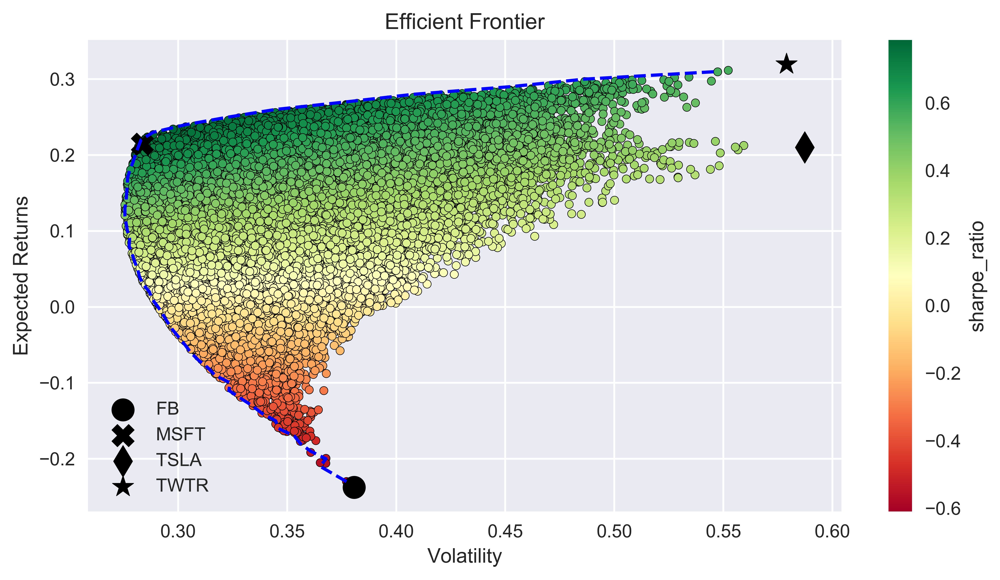

In [21]:
MARKS = ['o', 'X', 'd', '*']

fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.plot(portf_vol_ef, portf_rtns_ef, 'b--')
for asset_index in range(n_assets):
    ax.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=MARKS[asset_index], 
                s=150, 
                color='black',
                label=RISKY_ASSETS[asset_index])
ax.legend()

plt.tight_layout()
plt.show()

100.000 rasgele portföy simüle ettikten sonra, hangisinin en yüksek Sharpe oranına (birim risk başına, **Teğet(Tangency) Portföyü** olarak da bilinen beklenen maksimum getiri) veya minimum volatiliteye sahip olduğunu da araştırabiliriz. Bu portföyleri simüle edilenler arasında bulmak için dizideki minimum / maksimum değerin dizinini döndüren np.argmin ve np.argmax kullanıyoruz.

Kod aşağıdaki gibidir:

In [22]:
max_sharpe_ind = np.argmax(portf_results_df.sharpe_ratio)
max_sharpe_portf = portf_results_df.loc[max_sharpe_ind]

min_vol_ind = np.argmin(portf_results_df.volatility)
min_vol_portf = portf_results_df.loc[min_vol_ind]

Bu portföylerin bileşenlerini de araştırabiliriz:

In [23]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')
for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmax(portf_results_df.sharpe_ratio)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
returns: 23.42% volatility: 29.77% sharpe_ratio: 78.68% 
Weights
FB: 0.01% MSFT: 75.18% TSLA: 5.80% TWTR: 19.00% 

In [24]:
print('Minimum Volatility portfolio ----')
print('Performance')
for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmin(portf_results_df.volatility)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
returns: 13.45% volatility: 27.56% sharpe_ratio: 48.79% 
Weights
FB: 17.80% MSFT: 78.75% TSLA: 2.94% TWTR: 0.50% 

Maksimum Sharpe oran portföyü, kaynakların çoğunu (~% 75) Microsoft'a, neredeyse hiçbir şey Facebook'a tahsis etmiyor. Çünkü Facebook'un 2018 için yıllık ortalama getirileri negatifti.

Minimum volatilite portföyü, en düşük volatiliteye sahip hisse senedi olduğu için ağırlığın ~% 79'unu Microsoft'a atar (kovaryans matrisi izlenerek denetlenebilir)

Son olarak, bu iki portföyü Efficient Frontier grafiğinde işaretliyoruz. Bunu yapmak için, her biri bir nokta seçilen portföye karşılık gelen iki ekstra dağılım grafiği ekliyoruz. Daha sonra işaretleyici şeklini işaretleyici bağımsız değişkeniyle ve işaretleyici boyutunu s bağımsız değişkeniyle tanımlarız. Portföylerin boyutunu, portföyler arasında daha görünür hale getirmek için arttırıyoruz.

Kod aşağıdaki gibidir:

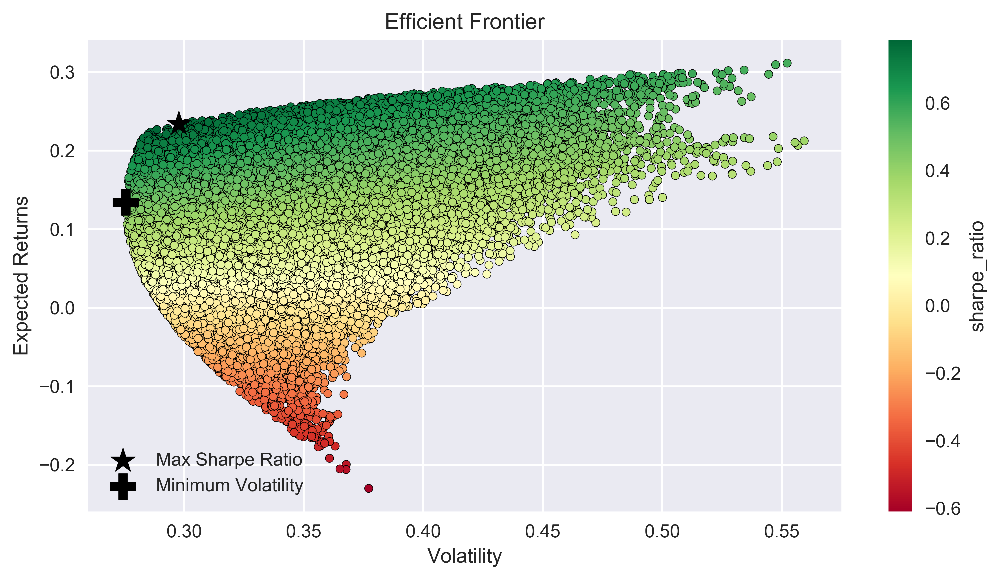

In [25]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.scatter(x=max_sharpe_portf.volatility, 
           y=max_sharpe_portf.returns, 
           c='black', marker='*', 
           s=200, label='Max Sharpe Ratio')
ax.scatter(x=min_vol_portf.volatility, 
           y=min_vol_portf.returns, 
           c='black', marker='P', 
           s=200, label='Minimum Volatility')
ax.set(xlabel='Volatility', ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.legend()

plt.tight_layout()
plt.show()

Grafiğin çok karmaşıklaşmasını önlemek için bireysel varlıkları ve Etkin Sınır hattını çizmedik.

# 3.`scipy` ile optimizasyon kullanarak Etkin Sınırın bulunması

Önceki başlıkta, Monte Carlo simülasyonlarını kullanarak Verimli Sınırı Bulmak'ta, Etkin Sınır'ı görselleştirmek için Monte Carlo simülasyonlarına dayanan kaba kuvvet yaklaşımı kullandık. Burada, sınırı belirlemek için daha rafine bir yöntem kullanıyoruz.

Verimli Sınır, tanımından, belirli bir oynaklık için beklenen en yüksek portföy getirisini sunan veya belirli bir beklenen getiri seviyesi için en düşük riski (oynaklık) sunan bir dizi portföyden oluşur. Bu gerçeği kullanabilir ve sayısal optimizasyonda kullanabiliriz. Optimizasyonun amacı, hedef değişkenleri ayarlayarak ve bazı sınırlar ve kısıtlamaları (hedef değişkenler üzerinde etkisi olan) dikkate alarak objektif fonksiyonun en iyi (optimal) değerini bulmaktır. Bu durumda, amaç işlevi portföy oynaklığını geri döndüren bir işlevdir ve hedef değişkenler portföy ağırlıklarıdır.

Matematiksel olarak problemi aşağıdaki gibi ifade edebiliriz:

$$\begin{array}{r}
\min w^{T} \Sigma w \\
\text { s.t. } \quad w^{T} \mathbf{1}=1 \\
w \geq 0 \\
w^{T} \mu=\mu_{p}
\end{array}$$

Burada $w$ ağırlık vektörü, $\Sigma$ kovaryans matrisi, $\mu$ getiri vektörü, ve $\mu_{p}$ beklenen portföy getirisidir.

Beklenen portföy getirileri aralığında en uygun portföy ağırlıklarını bulmak için kullanılan optimizasyon rutinini yineliyoruz ve bu da Etkin Sınır ile sonuçlanıyor.

Burada, her iki yaklaşımla elde edilen sonuçların benzer olduğunu göstermek için öncekiyle aynı veri kümesiyle birlikte çalışıyoruz.

Kütüphanelerin çağırılması:

In [26]:
import numpy as np
import scipy.optimize as sco

Portföy getirileri ve volatiliteyi hesaplayan fonksiyonların tanımlanması:

In [27]:
def get_portf_rtn(w, avg_rtns):
    return np.sum(avg_rtns * w)

def get_portf_vol(w, avg_rtns, cov_mat):
    return np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))

Etkin sınırı hesaplayan fonksiyonun tanımlanması:

In [28]:
def get_efficient_frontier(avg_rtns, cov_mat, rtns_range):
    
    efficient_portfolios = []
    
    n_assets = len(avg_returns)
    args = (avg_returns, cov_mat)
    bounds = tuple((0,1) for asset in range(n_assets))
    initial_guess = n_assets * [1. / n_assets, ]
    
    for ret in rtns_range:
        constraints = ({'type': 'eq', 
                        'fun': lambda x: get_portf_rtn(x, avg_rtns) - ret},
                       {'type': 'eq', 
                        'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portf_vol, initial_guess, 
                                           args=args, method='SLSQP', 
                                           constraints=constraints,
                                           bounds=bounds)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

İstenen getiri aralığının tanımlanması:

In [29]:
rtns_range = np.linspace(-0.22, 0.32, 200)

Etkin sınırın tanımlanması:

In [30]:
efficient_portfolios = get_efficient_frontier(avg_returns, 
                                              cov_mat, 
                                              rtns_range)

Etkin portföy volatilitelerinin çıkartılması:

In [31]:
vols_range = [x['fun'] for x in efficient_portfolios]

Simule edilmiş portföylerle birlikte etkin sınırın çizilmesi:

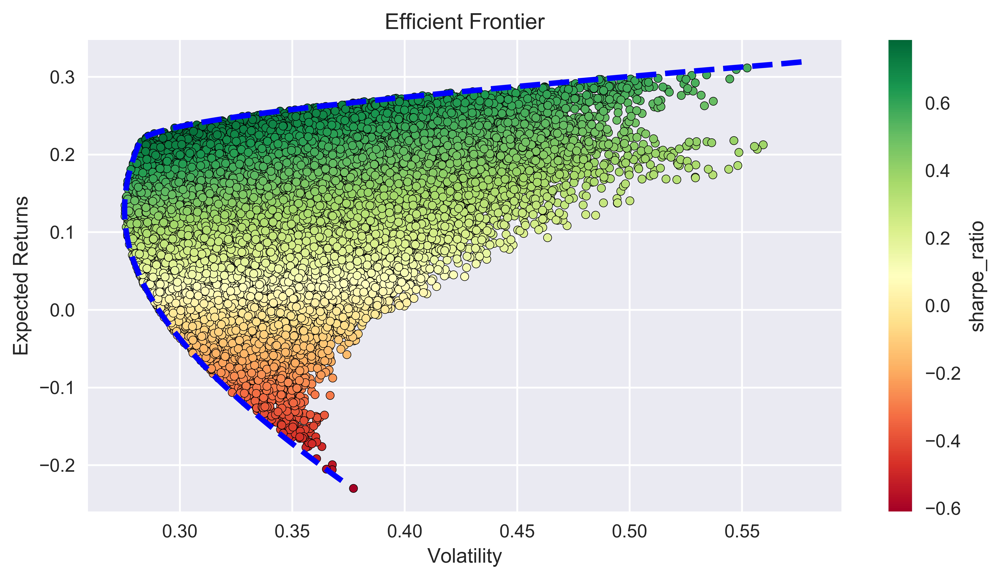

In [32]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.plot(vols_range, rtns_range, 'b--', linewidth=3)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

plt.tight_layout()
plt.show()

Etkin Sınır'ın Monte Carlo simülasyonları kullanılarak elde edilene çok benzer bir şekle sahip olduğunu görüyoruz. Tek fark, çizginin daha pürüzsüz olmasıdır.

Minimum volatiliteye sahip portföyün tanımlanması:

In [33]:
min_vol_ind = np.argmin(vols_range)
min_vol_portf_rtn = rtns_range[min_vol_ind]
min_vol_portf_vol = efficient_portfolios[min_vol_ind]['fun']

min_vol_portf = {'Return': min_vol_portf_rtn,
                 'Volatility': min_vol_portf_vol,
                 'Sharpe Ratio': (min_vol_portf_rtn / 
                                  min_vol_portf_vol)}

min_vol_portf

{'Return': 0.13005025125628142,
 'Volatility': 0.2754155993479624,
 'Sharpe Ratio': 0.47219638816454557}

Performans özeti:

In [34]:
print('Minimum Volatility portfolio ----')
print('Performance')

for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, efficient_portfolios[min_vol_ind]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
Return: 13.01% Volatility: 27.54% Sharpe Ratio: 47.22% 
Weights
FB: 18.65% MSFT: 77.34% TSLA: 4.01% TWTR: 0.00% 

Ayrıca, beklenen en yüksek Sharpe oranına sahip Teğetlik Portföyüne sahip bir portföy oluşturan ağırlıkları bulmak için optimizasyon yaklaşımını kullanabiliriz. Bunu yapmak için, önce Sharpe oranının negatif olan nesnel işlevi tanımlamamız gerekir. Negatifi kullanmamızın nedeni optimizasyon algoritmalarının minimizasyon problemleri çalıştırmasıdır. Hedef metriğin işaretini değiştirerek maksimizasyon problemlerine kolayca yaklaşabiliriz:

Hedef fonksiyonun(negatif Sharpe oranı) tanımlanması:

In [35]:
def neg_sharpe_ratio(w, avg_rtns, cov_mat, rf_rate):
    portf_returns = np.sum(avg_rtns * w)
    portf_volatility = np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))
    portf_sharpe_ratio = (portf_returns - rf_rate) / portf_volatility
    return -portf_sharpe_ratio

Optimize edilmiş portföyün bulunması:

In [36]:
n_assets = len(avg_returns)
RF_RATE = 0

args = (avg_returns, cov_mat, RF_RATE)
constraints = ({'type': 'eq', 
                'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(n_assets))
initial_guess = n_assets * [1. / n_assets]

max_sharpe_portf = sco.minimize(neg_sharpe_ratio, 
                                x0=initial_guess, 
                                args=args,
                                method='SLSQP', 
                                bounds=bounds, 
                                constraints=constraints)

Maksimum Sharpe oranıyla ilgili bilginin çıkartılması:

In [37]:
max_sharpe_portf_w = max_sharpe_portf['x']
max_sharpe_portf = {'Return': get_portf_rtn(max_sharpe_portf_w, 
                                            avg_returns),
                    'Volatility': get_portf_vol(max_sharpe_portf_w, 
                                                avg_returns, 
                                                cov_mat),
                    'Sharpe Ratio': -max_sharpe_portf['fun']}
max_sharpe_portf

{'Return': 0.2309718203015591,
 'Volatility': 0.2924975017373397,
 'Sharpe Ratio': 0.7896539933834029}

Performans özeti:

In [38]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, max_sharpe_portf_w):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 23.10% Volatility: 29.25% Sharpe Ratio: 78.97% 
Weights
FB: 0.00% MSFT: 81.50% TSLA: 2.79% TWTR: 15.72% 

# 4.`cvxpy` ile konveks optimizasyon kullanarak etkin sınırın bulunması

Önceki başlıkta, scipy ile optimizasyonu kullanarak Verimli Sınır'ı bulmak, scipy ile sayısal optimizasyonu kullanarak Efficient Frontier'ı bulduk. Portföy oynaklığını en aza indirmek istediğimiz metrik olarak kullandık. Bununla birlikte, aynı sorunu biraz farklı bir şekilde belirtmek ve Etkin Sınır'ı bulmak için dışbükey optimizasyonu kullanmak da mümkündür.

Ortalama-varyans optimizasyonu problemini, yatırımcının riske uyarlanmış getiriyi en üst düzeye çıkarmak istediği bir riskten kaçınma çerçevesine yeniden çerçeveleyebiliriz:

$$\begin{array}{cc}
\max & w^{T} \mu-\gamma w^{T} \Sigma w \\
\text { s.t. } & w^{T} \mathbf{1}=1 \\
& w \geq 0
\end{array}$$

Burada, $\gamma \in[0, \infty)$ riskten sakınma parametresi, ve kısıtlar ağırlıkların toplamının 1'e eşit olmasını ve açığa-satışın olmadığını göstermektedir. $\gamma$ büyüdükçe yatırımcı riskten daha fazla kaçar.

Kütüphanenin çağırılması:

In [40]:
import cvxpy as cp

Yıllık ortalama getirilerin ve kovaryans matrisinin numpy dizesine dönüştürülmesi:

In [41]:
avg_returns = avg_returns.values
cov_mat = cov_mat.values

Optimizasyon probleminin tanımlanması:

In [43]:
weights = cp.Variable(n_assets)
gamma = cp.Parameter(nonneg=True)
portf_rtn_cvx = avg_returns * weights 
portf_vol_cvx = cp.quad_form(weights, cov_mat)
objective_function = cp.Maximize(portf_rtn_cvx - gamma * portf_vol_cvx)
problem = cp.Problem(objective_function, 
                     [cp.sum(weights) == 1, weights >= 0])

C:\Users\mozturkmen\Anaconda3\lib\site-packages\cvxpy\expressions\expression.py:516: UserWarning: 
This use of ``*`` has resulted in matrix multiplication.
Using ``*`` for matrix multiplication has been deprecated since CVXPY 1.1.
    Use ``*`` for matrix-scalar and vector-scalar multiplication.
    Use ``@`` for matrix-matrix and matrix-vector multiplication.
    Use ``multiply`` for elementwise multiplication.

  warnings.warn(__STAR_MATMUL_WARNING__, UserWarning)


Etkin sınırın hesaplanması:

In [44]:
N_POINTS = 25
portf_rtn_cvx_ef = np.zeros(N_POINTS)
portf_vol_cvx_ef = np.zeros(N_POINTS)
weights_ef = []
gamma_range = np.logspace(-3, 3, num=N_POINTS)

for i in range(N_POINTS):
    gamma.value = gamma_range[i]
    problem.solve()
    portf_vol_cvx_ef[i] = cp.sqrt(portf_vol_cvx).value
    portf_rtn_cvx_ef[i] = portf_rtn_cvx.value
    weights_ef.append(weights.value)

Farklı riskten kaçınma parametreleri için tahsisin çizilmesi:

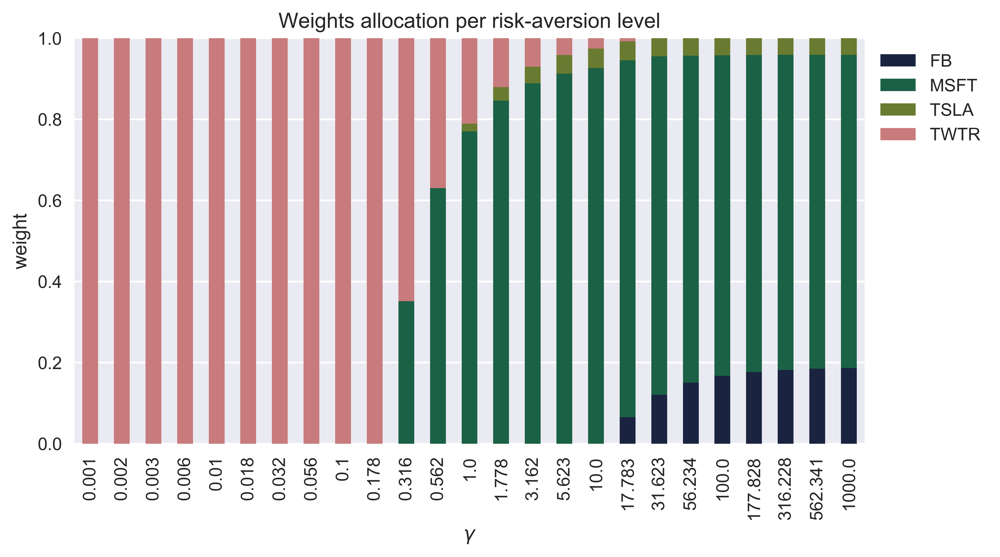

In [45]:
weights_df = pd.DataFrame(weights_ef, 
                          columns=RISKY_ASSETS, 
                          index=np.round(gamma_range, 3))
ax = weights_df.plot(kind='bar', stacked=True) 
ax.set(title='Weights allocation per risk-aversion level',
       xlabel=r'$\gamma$', 
       ylabel='weight')
ax.legend(bbox_to_anchor=(1,1))

plt.tight_layout()
plt.show()

Bireysel varlıklarla birlikte etkin sınırın çizilmesi:

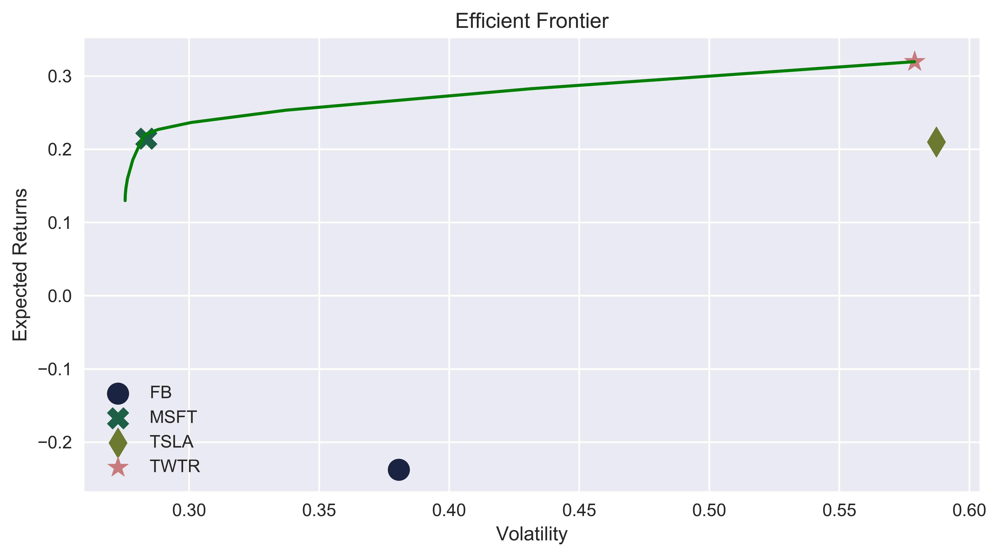

In [46]:
#MARKS = ['o', 'X', 'd', '*']

fig, ax = plt.subplots()
ax.plot(portf_vol_cvx_ef, portf_rtn_cvx_ef, 'g-')
for asset_index in range(n_assets):
     plt.scatter(x=np.sqrt(cov_mat[asset_index, asset_index]), 
                 y=avg_returns[asset_index], 
                 marker=MARKS[asset_index], 
                 label=RISKY_ASSETS[asset_index],
                 s=150)
ax.set(title='Efficient Frontier',
       xlabel='Volatility', 
       ylabel='Expected Returns', )
ax.legend()

plt.tight_layout()
plt.show()

Karşılaştırma için iki Etkin Sınırı da çizebiliriz - biri beklenen dönüş seviyesi başına oynaklığı en aza indirerek hesaplanırken, diğeri dışbükey optimizasyonu kullanarak ve riske göre ayarlanmış getiriyi en üst düzeye çıkararak hesaplanır.

Kod aşağıdaki gibidir:

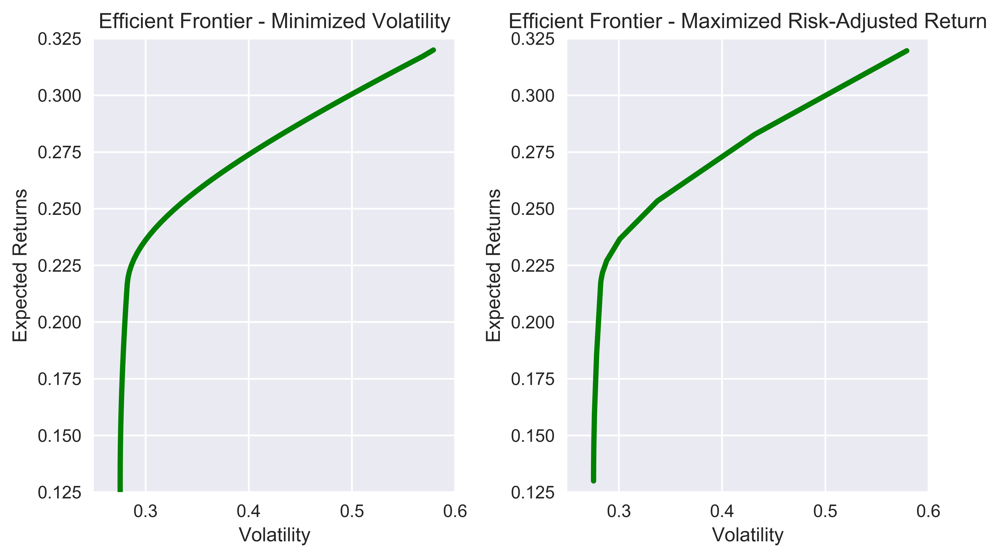

In [47]:
x_lim = [0.25, 0.6]
y_lim = [0.125, 0.325]

fig, ax = plt.subplots(1, 2)
ax[0].plot(vols_range, rtns_range, 'g-', linewidth=3)
ax[0].set(title='Efficient Frontier - Minimized Volatility',
          xlabel='Volatility', 
          ylabel='Expected Returns',
          xlim=x_lim, 
          ylim=y_lim)

ax[1].plot(portf_vol_cvx_ef, portf_rtn_cvx_ef, 'g-', linewidth=3)
ax[1].set(title='Efficient Frontier - Maximized Risk-Adjusted Return',
          xlabel='Volatility', 
          ylabel='Expected Returns',
          xlim=x_lim, 
          ylim=y_lim)

plt.tight_layout()
plt.show()

Analize dahil edebileceğimiz bir diğer ilginç kavram, izin verilen maksimum kaldıraçtır. Ağırlıklardaki olumsuzluk kısıtlamalarını bir vektörün normunu kullanarak maksimum kaldıraç kısıtlamasıyla değiştiriyoruz.

Aşağıdaki kodda, yalnızca önceki kod bloğuna eklenenleri gösteriyoruz:

In [48]:
max_leverage = cp.Parameter()
problem_with_leverage = cp.Problem(objective_function, 
                                   [cp.sum(weights) == 1, 
                                    cp.norm(weights, 1) <= max_leverage])

Aşağıdaki kod bloğunda, bu kez iki döngü içerecek şekilde kod değiştiriyoruz - biri riskten kaçınma parametresinin potansiyel değerleri üzerinden diğeri ise izin verilen maksimum kaldıraç değerini gösteriyor. 1'e eşit olan maksimum kaldıraç (kaldıraç yok demektir) önceki optimizasyon problemine benzer bir durumla sonuçlanır (sadece bu sefer olumsuzluk kısıtlaması yoktur).

Ayrıca, ağırlıklar durumunda sonuçları daha büyük 2B matrisler (np.ndarraylar) olarak veya üçüncü bir boyut içerecek şekilde depolayarak nesneleri yeniden tanımlarız.

Kod aşağıdaki gibidir:

In [49]:
LEVERAGE_RANGE = [1, 2, 5]
len_leverage = len(LEVERAGE_RANGE)
N_POINTS = 25

portf_vol_l_ef = np.zeros((N_POINTS, len_leverage))
portf_rtn_l_ef = np.zeros(( N_POINTS, len_leverage))
weights_ef = np.zeros((len_leverage, N_POINTS, n_assets))

for lev_ind, leverage in enumerate(LEVERAGE_RANGE):
    for gamma_ind in range(N_POINTS):
        max_leverage.value = leverage
        gamma.value = gamma_range[gamma_ind]
        problem_with_leverage.solve()
        portf_vol_l_ef[gamma_ind, lev_ind] = cp.sqrt(portf_vol_cvx).value
        portf_rtn_l_ef[gamma_ind, lev_ind] = portf_rtn_cvx.value
        weights_ef[lev_ind, gamma_ind, :] = weights.value

Aşağıdaki kod bloğunda, farklı maksimum kaldıraçlar için Verimli Sınırları çiziyoruz. Daha yüksek kaldıraçın getirileri artırdığını ve aynı zamanda daha fazla oynaklığa izin verdiğini açıkça görebiliriz:

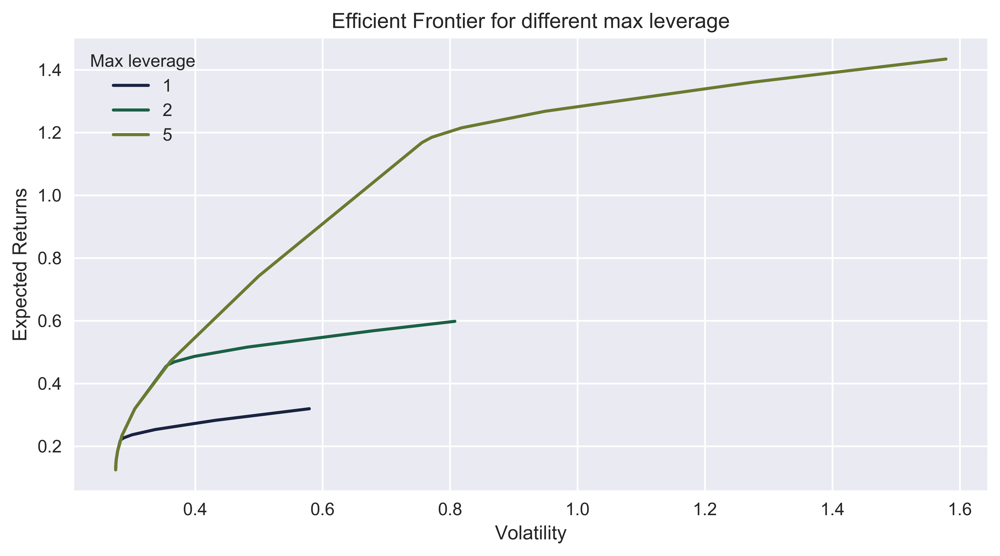

In [50]:
fig, ax = plt.subplots()

for leverage_index, leverage in enumerate(LEVERAGE_RANGE):
    plt.plot(portf_vol_l_ef[:, leverage_index], 
             portf_rtn_l_ef[:, leverage_index], 
             label=f'{leverage}')

ax.set(title='Efficient Frontier for different max leverage',
       xlabel='Volatility', 
       ylabel='Expected Returns')
ax.legend(title='Max leverage')

plt.tight_layout()
plt.show()

Son olarak, değişen riskten kaçınma seviyelerine göre ağırlık dağılımını gösteren grafiği yeniden yaratıyoruz. Maksimum 1 kaldıraç ile açığa satış yoktur.

Kod aşağıdaki gibidir:

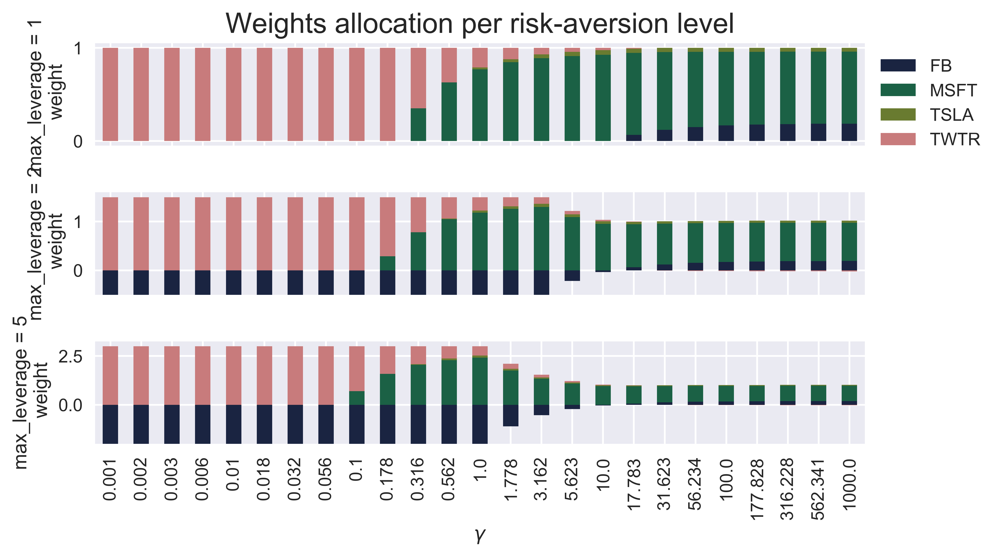

In [51]:
fig, ax = plt.subplots(len_leverage, 1, sharex=True)

for ax_index in range(len_leverage):
    weights_df = pd.DataFrame(weights_ef[ax_index], 
                              columns=RISKY_ASSETS, 
                              index=np.round(gamma_range, 3))
    weights_df.plot(kind='bar', 
                    stacked=True, 
                    ax=ax[ax_index], 
                    legend=None) 
    ax[ax_index].set(ylabel=(f'max_leverage = {LEVERAGE_RANGE[ax_index]}' 
                             '\n weight'))

    
ax[len_leverage - 1].set(xlabel=r'$\gamma$')
ax[0].legend(bbox_to_anchor=(1,1)) 
ax[0].set_title('Weights allocation per risk-aversion level',
                fontsize=16)

plt.tight_layout()
plt.show()